In [4]:
import os
import glob
import re
import datetime
import math
from datetime import date, time, timedelta
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics.pairwise import cosine_similarity
from itertools import chain
from cv2 import VideoCapture, CAP_PROP_FRAME_COUNT, CAP_PROP_FPS, CAP_PROP_POS_FRAMES
import cv2
from PIL import Image
import ffmpeg
from imutils.video import FileVideoStream
import imutils
import time
import glob
from bokeh.plotting import figure, show
from bokeh.io import output_notebook, export_svg
from bokeh.models import Span, DatetimeTicker, DatetimeTickFormatter
import pytesseract
from utils import load_diffs, load_slide_changes, load_intervals
from utils import filter_video, plot_slide_diffs, get_signals, get_hmm_signals, evaluate
from hmmlearn import hmm
from nltk.tokenize import word_tokenize, regexp_tokenize


sns.set()
output_notebook()

Loading BokehJS ...

In [5]:
def add_median(data, **kwargs):
    median = data.wc.median()
    ax = plt.gca()
    ax.axhline(median, **kwargs)

In [6]:
def mask_rh_corner(frame, w, h):
    if not (isinstance(w, (float, int)) and isinstance(h, (float, int))):
        raise ValueError(f"w and h must both be float or int type, instead got w: {type(w)}, h: {type(h)}")
    if isinstance(w, float):
        w = int(frame.shape[1] * (1 - w))
    if isinstance(h, float):
        h = int(frame.shape[0] * h)

    frame[:h, w:, :] = 0
    
    return frame

---
# Meeting ID = 83512718053
---

# Set video variables and build paths

In [7]:
meeting_id = 83512718053

In [8]:
video_path = glob.glob(f'zoom_data/{meeting_id}/*.mp4')[0]
print(video_path)
diff_path = f'diff_data/diffs_{meeting_id}_pct_masked_cossim.csv'
sc_labels = f'slide_change_labels/{meeting_id}.csv'
interval_path = 'interval_data/intervals.csv'

zoom_data/83512718053/GMT20210527-002121_Recording_1920x1200.mp4


# Load true slide changes

In [9]:
sldf = load_slide_changes(sc_labels)
sldf.head()

,change_time,note,change_time_dt
0,0:8:20,NaN,1970-01-01 00:08:20
1,0:9:29,NaN,1970-01-01 00:09:29
2,0:9:35,NaN,1970-01-01 00:09:35
3,0:10:23,NaN,1970-01-01 00:10:23
4,0:10:58,NaN,1970-01-01 00:10:58


In [ ]:
#sldf.loc[36, 'change_time_dt'] = sldf.loc[36, 'change_time_dt'] + pd.Timedelta(1, unit='s')

# Load Video

In [ ]:
vidcap = VideoCapture(video_path)

In [ ]:
fps = vidcap.get(CAP_PROP_FPS)
fps

25.0

# Get slide change predictions

In [ ]:
ddiffs = load_diffs(diff_path, fps)
idf = load_intervals(interval_path, meeting_id=meeting_id)
ddiffs = filter_video(ddiffs, idf)

In [ ]:
hmm_model = hmm.GaussianHMM(n_components=2)
signals = get_hmm_signals(ddiffs, hmm_model)
signals.loc[:, 'signal'] = signals.signal.astype(bool)
signals.head()

,elapsed_dt,signal
0,1970-01-01 00:07:52,False
1,1970-01-01 00:07:53,False
2,1970-01-01 00:07:54,False
3,1970-01-01 00:07:55,False
4,1970-01-01 00:07:56,False


# Map seconds to frames

In [ ]:
diffs = pd.read_csv(diff_path, usecols=['meeting_id', 'cos_sim'])
diffs['frame'] = diffs.index + 1
diffs['cos_sim'] = 1 - diffs.cos_sim
diffs['second'] = diffs.index.to_numpy() // fps
diffs['is_max'] = diffs.groupby(['meeting_id', 'second'], as_index=False).cos_sim.transform(lambda x: (x == x.max()).astype(int))

In [ ]:
_ddiffs = diffs.groupby(['meeting_id', 'second'], as_index=False)[['cos_sim']].max()
sec_to_frame = _ddiffs.merge(diffs[['meeting_id', 'second', 'cos_sim', 'frame']], how='left', on=['meeting_id', 'second', 'cos_sim']) \
                      .groupby(['meeting_id', 'second', 'cos_sim'], as_index=False) \
                      .frame \
                      .max()
sec_to_frame.head()

,meeting_id,second,cos_sim,frame
0,83512718053,0.0,1.000000,13
1,83512718053,1.0,0.000116,47
2,83512718053,2.0,0.000167,70
3,83512718053,3.0,0.000168,99
4,83512718053,4.0,0.000224,113


In [ ]:
sldf['second'] = (sldf.change_time_dt - pd.to_datetime('1970-01-01', format='%Y-%m-%d %H:%M:%S')).dt.total_seconds().astype(int)
sldf['fps_frame'] = (sldf.second * fps).astype(int)
sldf = sldf.merge(sec_to_frame[['second', 'frame']], how='left', on='second') \
           .rename(columns={'frame': 's2f_frame'})
sldf['slide'] = sldf.index + 2
sldf.head()

,change_time,note,change_time_dt,second,fps_frame,s2f_frame,slide
0,0:8:20,NaN,1970-01-01 00:08:20,500,12500,12515,2
1,0:9:29,NaN,1970-01-01 00:09:29,569,14225,14237,3
2,0:9:35,NaN,1970-01-01 00:09:35,575,14375,14399,4
3,0:10:23,NaN,1970-01-01 00:10:23,623,15575,15591,5
4,0:10:58,NaN,1970-01-01 00:10:58,658,16450,16454,6


# Visualize

## Raw diffs

In [56]:
p = figure(plot_width=1400, plot_height=500)
p.line(diffs.frame, diffs.cos_sim, line_width=2, line_alpha=0.5)
show(p)

## Discretized diffs with predictions and ground truth slide changes

In [17]:
plot_slide_diffs(ddiffs, sldf=sldf, signals=signals)

Figure(id='1106', ...)

## Extracted slides - based on ground truth annotations

In [18]:
slides_true = []
for i, ts in enumerate(sldf.s2f_frame):
    vidcap.set(1, ts)
    success, s = vidcap.read()
    if not success:
        raise ValueError(f"Slide {i} at second mark {ts} not read correctly")
    s = mask_rh_corner(s, 0.17, 0.16)
    slides_true.append(s)

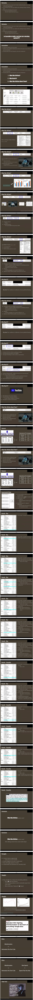

In [61]:
frame_w = 20
frame_h = 10
num_cols = 1
num_rows = math.ceil(len(slides_true) / num_cols)
fig, ax = plt.subplots(num_rows, num_cols, figsize=(frame_w * num_cols, frame_h * num_rows))
for a in ax.flatten():
    a.grid(False)
    a.set_xticks([])
    a.set_yticks([])
for i, (s, a) in enumerate(zip(slides_true, ax.flatten())):
    a.imshow(s)
    a.set_title(f"Slide {i + 2}", size=15)
plt.tight_layout()
plt.show()

### Investigate errors

There is some error with respect to the frames that get extracted.  In theory, we should be able to use the ground truth annotations to map elapsed seconds to a frame number.  This should result in one frame extracted per unique slide in the presentation.  However, sometimes we can extract the wrong frame for a particular slide, which will result in duplicating the previous slide.  This happens when the slide change is close to the beginning or end of a given second.  Since there are many frames in a second, the human annotator may not get the second correct in that scenario.

#### Meeting ID = 83512718053

In [15]:
sldf.query("slide in [37, 38, 39]")

,change_time,note,change_time_dt,second,fps_frame,s2f_frame,slide
35,0:33:48,NaN,1970-01-01 00:33:48,2028,50700,50703,37
36,0:33:57,NaN,1970-01-01 00:33:57,2037,50925,50945,38
37,0:34:19,NaN,1970-01-01 00:34:19,2059,51475,51500,39


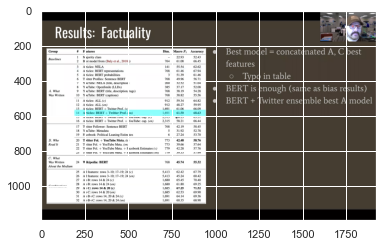

In [16]:
vidcap.set(1, 50703)
_, s1 = vidcap.read()
plt.imshow(s1);

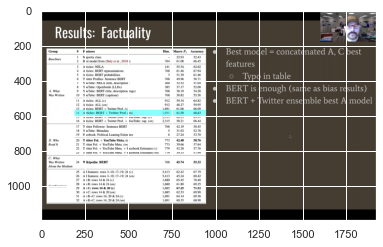

In [17]:
vidcap.set(1, 50945)
_, s2 = vidcap.read()
plt.imshow(s2);

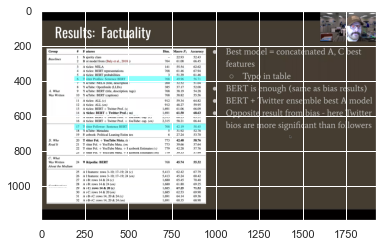

In [18]:
# True slide change happens at 50953
vidcap.set(1, 50953)
_, s2 = vidcap.read()
plt.imshow(s2);

#### Plot mismapping issue

In [63]:
# This range of seconds captures the bad frame
#diffs_subset = diffs.query("second >= 2037 and second <= 2039")
diffs_subset = diffs.query("frame >= 50926 and frame <= 50976")

In [69]:
p = figure(plot_width=1400, plot_height=500)
p.line(diffs_subset.frame, diffs_subset.cos_sim, line_width=2, line_alpha=1, line_color='black')
#p.circle(diffs_subset.query("is_max == 1").frame, diffs_subset.query("is_max == 1").cos_sim, color='red', alpha=0.4, legend_label='max cos sim delta')
#p.square(diffs_subset.groupby('second').frame.min(), 0, color='black', legend_label='second transition')
p.varea(x=diffs_subset.query("frame >= 50926 and frame <= 50951").frame, y1=0, y2=diffs_subset.cos_sim.max() + 0.0002,
          alpha=0.2, fill_color='#fc0305', legend_label="annotated")
p.varea(x=diffs_subset.query("frame >= 50951 and frame <= 50976").frame, y1=0, y2=diffs_subset.cos_sim.max() + 0.0002,
          alpha=0.2, fill_color='#55FF88', legend_label="actual")
p.xaxis.axis_label = "Frame #"
p.xaxis.axis_label_text_font_size = "20pt"
p.yaxis.axis_label = "Cosine Distance (diff)"
p.yaxis.axis_label_text_font_size = "20pt"
p.legend.label_text_font_size = "13pt"
p.output_backend = "svg"
export_svg(p, filename=f"thesis/mscs_thesis/figures/3_3_2_framemap_error.svg")
show(p)

## Extracted slides - based on predicted slide changes

In [19]:
predictions = signals.query("signal").reset_index(drop=True)
predictions.head()

,elapsed_dt,signal
0,1970-01-01 00:08:20,True
1,1970-01-01 00:09:28,True
2,1970-01-01 00:09:34,True
3,1970-01-01 00:10:22,True
4,1970-01-01 00:10:58,True


In [20]:
predictions['second'] = (predictions.elapsed_dt - pd.to_datetime('1970-01-01', format='%Y-%m-%d %H:%M:%S')).dt.total_seconds().astype(int)
predictions['fps_frame'] = (predictions.second * fps).astype(int)
predictions = predictions.merge(sec_to_frame[['second', 'frame']], how='left', on='second') \
           .rename(columns={'frame': 's2f_frame'})
predictions['slide'] = predictions.index + 2
predictions.head()

,elapsed_dt,signal,second,fps_frame,s2f_frame,slide
0,1970-01-01 00:08:20,True,500,12500,12515,2
1,1970-01-01 00:09:28,True,568,14200,14205,3
2,1970-01-01 00:09:34,True,574,14350,14369,4
3,1970-01-01 00:10:22,True,622,15550,15575,5
4,1970-01-01 00:10:58,True,658,16450,16454,6


In [21]:
slides_pred = []
for i, ts in enumerate(predictions.s2f_frame):
    vidcap.set(1, ts)
    success, s = vidcap.read()
    if not success:
        raise ValueError(f"Slide {i} at second mark {ts} not read correctly")
    s = mask_rh_corner(s, 0.17, 0.16)
    slides_pred.append(s)

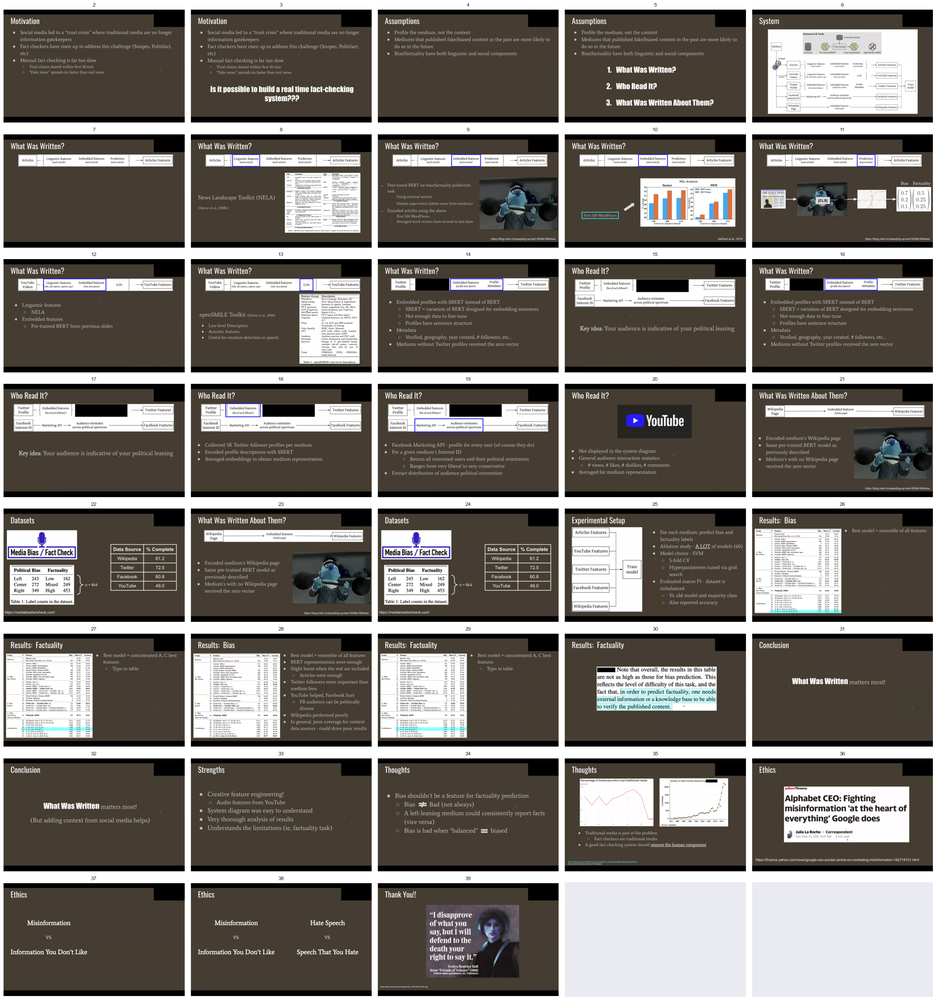

In [27]:
num_cols = 5
num_rows = (len(slides_pred) // num_cols) + 1
fig, ax = plt.subplots(num_rows, num_cols, figsize=(30, 4 * num_rows))
for a in ax.flatten():
    a.grid(False)
    a.set_xticks([])
    a.set_yticks([])
for i, (s, a) in enumerate(zip(slides_pred, ax.flatten())):
    a.imshow(s)
    a.set_title(i + 2)
plt.tight_layout()
plt.show()

# Calculate Word Counts - ground truth

In [22]:
wc_true = []
for f in slides_true:
    color_coverted = cv2.cvtColor(f, cv2.COLOR_BGR2RGB)
    extracted = pytesseract.image_to_string(color_coverted)
    wc = len(regexp_tokenize(extracted, pattern='\w+'))
    wc_true.append(wc)

In [23]:
wc_true_df = pd.DataFrame({'wc': wc_true})
wc_true_df['slide'] = wc_true_df.index + 2
wc_true_df['wc_type'] = 'true'
wc_true_df.head()

,wc,slide,wc_type
0,54,2,true
1,62,3,true
2,37,4,true
3,43,5,true
4,88,6,true


# Calculate Word Counts - predictions

In [24]:
wc_pred = []
for f in slides_pred:
    color_coverted = cv2.cvtColor(f, cv2.COLOR_BGR2RGB)
    extracted = pytesseract.image_to_string(color_coverted)
    wc = len(regexp_tokenize(extracted, pattern='\w+'))
    wc_pred.append(wc)

In [25]:
wc_pred_df = pd.DataFrame({'wc': wc_pred})
wc_pred_df['slide'] = wc_pred_df.index + 2
wc_pred_df['wc_type'] = 'predicted'
wc_pred_df.head()

,wc,slide,wc_type
0,54,2,predicted
1,63,3,predicted
2,37,4,predicted
3,43,5,predicted
4,88,6,predicted


# Visualize word counts

/Users/jackcan/miniconda3/envs/thesis/lib/python3.7/site-packages/ipykernel_launcher.py:11: UserWarning: FixedFormatter should only be used together with FixedLocator
  # This is added back by InteractiveShellApp.init_path()


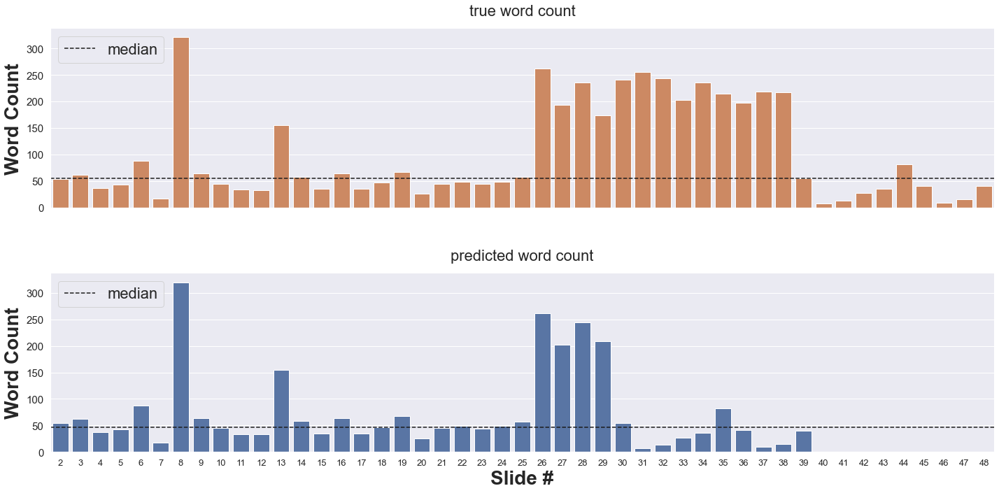

In [30]:
wc_df = pd.concat([wc_true_df, wc_pred_df])
g = sns.catplot(x='slide', y='wc', row='wc_type', row_order=['true', 'predicted'], data=wc_df, kind='bar',
                hue='wc_type', dodge=False, height=5
                ,hue_order=['predicted', 'true']
                ,aspect=4)
g.map_dataframe(add_median, linestyle='dashed', color='k', label='median')
g.set_titles(row_template="{row_name} word count", size=22, y=1.05)
g.set_xlabels("Slide #", size=28, fontweight='bold')
for ax in g.axes.flat:
    ax.set_ylabel("Word Count", size=28, fontweight='bold')
    ax.set_yticklabels(ax.get_yticklabels(), size=15)
    ax.set_xticklabels(ax.get_xticklabels(), size=13)
    handles, labels = ax.get_legend_handles_labels()
    for handle, label in zip(handles, labels):
        if label == 'median':
            ax.legend([handle], [label], loc='upper left', fontsize=22)
g.tight_layout(h_pad=4)
plt.savefig("thesis/mscs_thesis/figures/3_3_2_hmm_wc_83512718053.pdf", dpi=300, bbox_inches='tight')
#plt.suptitle(f"Word Count Comparison - true vs.  predicted\n(meeting_id = {meeting_id})", size=25, y=1.1);

In [33]:
wc_df['meeting_id'] = meeting_id
out_df = wc_df.copy(deep=True)

---
# Meeting ID = 160320
---

# Set video variables and build paths

In [34]:
meeting_id = 160320

In [35]:
video_path = glob.glob(f'zoom_data/{meeting_id}/*.mp4')[0]
print(video_path)
diff_path = f'diff_data/diffs_{meeting_id}_pct_masked_cossim.csv'
sc_labels = f'slide_change_labels/{meeting_id}.csv'
interval_path = 'interval_data/intervals.csv'

zoom_data/160320/GMT20210614-160320_Recording_2020x1380.mp4


# Load true slide changes

In [36]:
sldf = load_slide_changes(sc_labels)
sldf.head()

,change_time,note,change_time_dt
0,0:1:22,NaN,1970-01-01 00:01:22
1,0:1:56,NaN,1970-01-01 00:01:56
2,0:2:01,NaN,1970-01-01 00:02:01
3,0:3:34,Revisited 2 slides back,1970-01-01 00:03:34
4,0:6:39,Fast forward 2 slides to next slide,1970-01-01 00:06:39


# Load Video

In [37]:
vidcap = VideoCapture(video_path)

In [38]:
fps = vidcap.get(CAP_PROP_FPS)
fps

25.0

# Get slide change predictions

In [39]:
ddiffs = load_diffs(diff_path, fps)
idf = load_intervals(interval_path, meeting_id=meeting_id)
ddiffs = filter_video(ddiffs, sldf, idf)

In [40]:
hmm_model = hmm.GaussianHMM(n_components=2)
signals = get_hmm_signals(ddiffs, hmm_model)
signals.loc[:, 'signal'] = signals.signal.astype(bool)
signals.head()

,elapsed_dt,signal
0,1970-01-01 00:00:01,False
1,1970-01-01 00:00:02,False
2,1970-01-01 00:00:03,False
3,1970-01-01 00:00:04,False
4,1970-01-01 00:00:05,False


# Map seconds to frames

In [41]:
diffs = pd.read_csv(diff_path, usecols=['meeting_id', 'cos_sim'])
diffs['frame'] = diffs.index + 1
diffs['cos_sim'] = 1 - diffs.cos_sim
diffs['second'] = diffs.index.to_numpy() // fps
diffs['is_max'] = diffs.groupby(['meeting_id', 'second'], as_index=False).cos_sim.transform(lambda x: (x == x.max()).astype(int))

In [42]:
_ddiffs = diffs.groupby(['meeting_id', 'second'], as_index=False)[['cos_sim']].max()
sec_to_frame = _ddiffs.merge(diffs[['meeting_id', 'second', 'cos_sim', 'frame']], how='left', on=['meeting_id', 'second', 'cos_sim']) \
                      .groupby(['meeting_id', 'second', 'cos_sim'], as_index=False) \
                      .frame \
                      .max()
sec_to_frame.head()

,meeting_id,second,cos_sim,frame
0,160320,0.0,1.000000,7
1,160320,1.0,0.000017,36
2,160320,2.0,0.000055,59
3,160320,3.0,0.000054,77
4,160320,4.0,0.000022,108


In [43]:
sldf['second'] = (sldf.change_time_dt - pd.to_datetime('1970-01-01', format='%Y-%m-%d %H:%M:%S')).dt.total_seconds().astype(int)
sldf['fps_frame'] = (sldf.second * fps).astype(int)
sldf = sldf.merge(sec_to_frame[['second', 'frame']], how='left', on='second') \
           .rename(columns={'frame': 's2f_frame'})
sldf['slide'] = sldf.index + 2
sldf.head()

,change_time,note,change_time_dt,second,fps_frame,s2f_frame,slide
0,0:1:22,NaN,1970-01-01 00:01:22,82,2050,2065,2
1,0:1:56,NaN,1970-01-01 00:01:56,116,2900,2901,3
2,0:2:01,NaN,1970-01-01 00:02:01,121,3025,3032,4
3,0:3:34,Revisited 2 slides back,1970-01-01 00:03:34,214,5350,5357,5
4,0:6:39,Fast forward 2 slides to next slide,1970-01-01 00:06:39,399,9975,9977,6


# Visualize

## Raw diffs

In [44]:
p = figure(plot_width=1400, plot_height=500)
p.line(diffs.frame, diffs.cos_sim, line_width=2, line_alpha=0.5)
show(p)

## Discretized diffs with predictions and ground truth slide changes

In [45]:
plot_slide_diffs(ddiffs, sldf=sldf, signals=signals)

## Extracted slides - based on ground truth annotations

In [46]:
slides_true = []
for i, ts in enumerate(sldf.s2f_frame):
    vidcap.set(1, ts)
    success, s = vidcap.read()
    if not success:
        raise ValueError(f"Slide {i} at second mark {ts} not read correctly")
    slides_true.append(s)

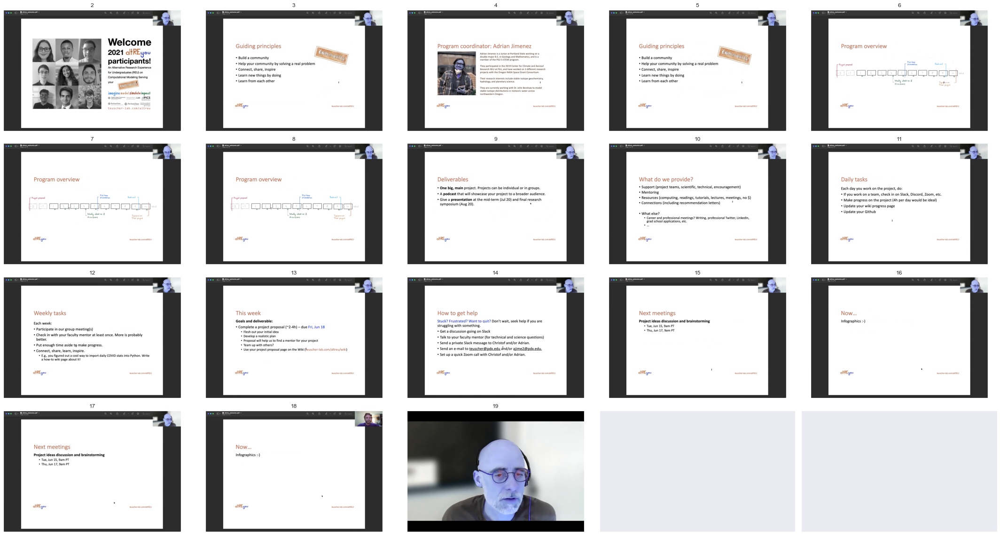

In [47]:
num_cols = 5
num_rows = (len(slides_true) // num_cols) + 1
fig, ax = plt.subplots(num_rows, num_cols, figsize=(30, 4 * num_rows))
for a in ax.flatten():
    a.grid(False)
    a.set_xticks([])
    a.set_yticks([])
for i, (s, a) in enumerate(zip(slides_true, ax.flatten())):
    a.imshow(s)
    a.set_title(i + 2)
plt.tight_layout()
plt.show()

## Extracted slides - based on predicted slide changes

In [48]:
predictions = signals.query("signal").reset_index(drop=True)
predictions.head()

,elapsed_dt,signal
0,1970-01-01 00:01:21,True
1,1970-01-01 00:01:55,True
2,1970-01-01 00:02:00,True
3,1970-01-01 00:03:34,True
4,1970-01-01 00:06:38,True


In [49]:
predictions['second'] = (predictions.elapsed_dt - pd.to_datetime('1970-01-01', format='%Y-%m-%d %H:%M:%S')).dt.total_seconds().astype(int)
predictions['fps_frame'] = (predictions.second * fps).astype(int)
predictions = predictions.merge(sec_to_frame[['second', 'frame']], how='left', on='second') \
           .rename(columns={'frame': 's2f_frame'})
predictions['slide'] = predictions.index + 2
predictions.head()

,elapsed_dt,signal,second,fps_frame,s2f_frame,slide
0,1970-01-01 00:01:21,True,81,2025,2034,2
1,1970-01-01 00:01:55,True,115,2875,2899,3
2,1970-01-01 00:02:00,True,120,3000,3009,4
3,1970-01-01 00:03:34,True,214,5350,5357,5
4,1970-01-01 00:06:38,True,398,9950,9968,6


In [50]:
slides_pred = []
for i, ts in enumerate(predictions.s2f_frame):
    vidcap.set(1, ts)
    success, s = vidcap.read()
    if not success:
        raise ValueError(f"Slide {i} at second mark {ts} not read correctly")
    slides_pred.append(s)

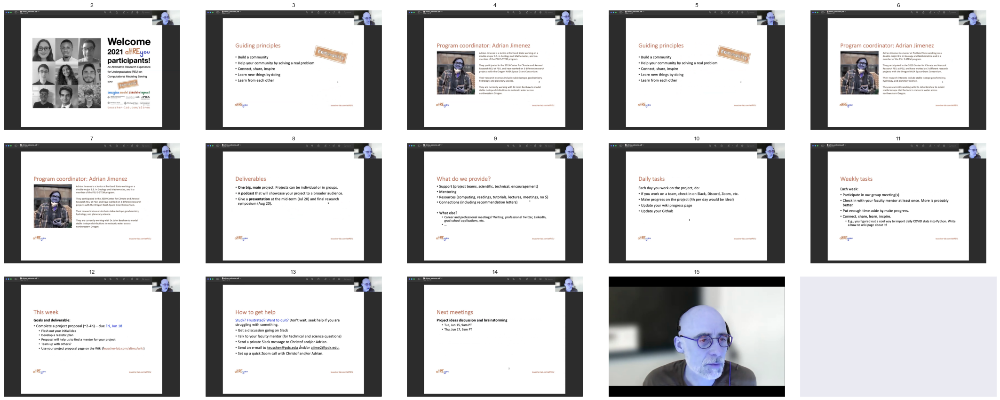

In [51]:
num_cols = 5
num_rows = (len(slides_pred) // num_cols) + 1
fig, ax = plt.subplots(num_rows, num_cols, figsize=(30, 4 * num_rows))
for a in ax.flatten():
    a.grid(False)
    a.set_xticks([])
    a.set_yticks([])
for i, (s, a) in enumerate(zip(slides_pred, ax.flatten())):
    a.imshow(s)
    a.set_title(i + 2)
plt.tight_layout()
plt.show()

# Calculate Word Counts - ground truth

In [52]:
wc_true = []
for f in slides_true:
    color_coverted = cv2.cvtColor(f, cv2.COLOR_BGR2RGB)
    extracted = pytesseract.image_to_string(color_coverted)
    wc = len(regexp_tokenize(extracted, pattern='\w+'))
    wc_true.append(wc)

In [53]:
wc_true_df = pd.DataFrame({'wc': wc_true})
wc_true_df['slide'] = wc_true_df.index + 2
wc_true_df['wc_type'] = 'true'
wc_true_df.head()

,wc,slide,wc_type
0,37,2,true
1,28,3,true
2,92,4,true
3,27,5,true
4,21,6,true


# Calculate Word Counts - predictions

In [54]:
wc_pred = []
for f in slides_pred:
    color_coverted = cv2.cvtColor(f, cv2.COLOR_BGR2RGB)
    extracted = pytesseract.image_to_string(color_coverted)
    wc = len(regexp_tokenize(extracted, pattern='\w+'))
    wc_pred.append(wc)

In [55]:
wc_pred_df = pd.DataFrame({'wc': wc_pred})
wc_pred_df['slide'] = wc_pred_df.index + 2
wc_pred_df['wc_type'] = 'pred'
wc_pred_df.head()

,wc,slide,wc_type
0,37,2,pred
1,28,3,pred
2,89,4,pred
3,27,5,pred
4,95,6,pred


# Visualize word counts

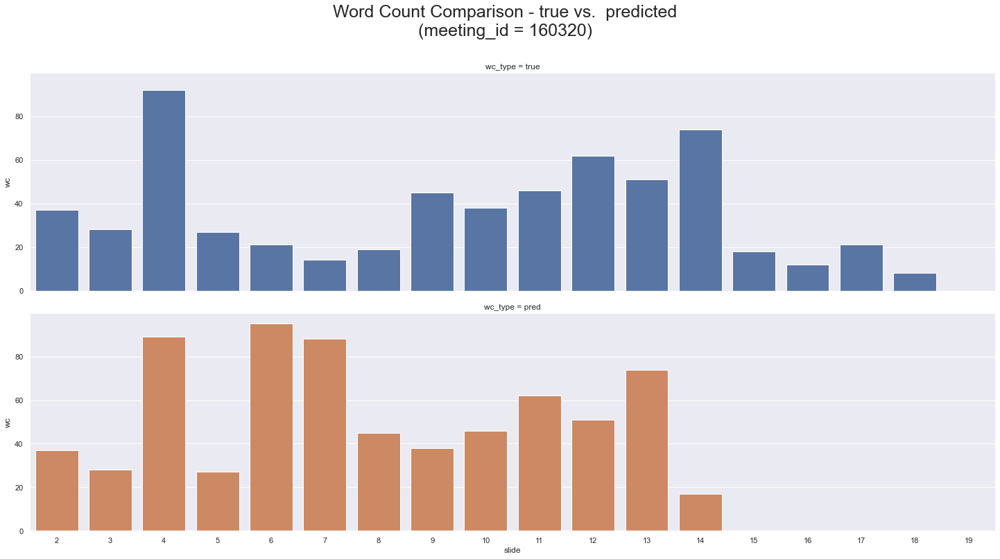

In [56]:
wc_df = pd.concat([wc_true_df, wc_pred_df])
sns.catplot(x='slide', y='wc', row='wc_type', data=wc_df, kind='bar',
            hue='wc_type', dodge=False, height=5, aspect=4)
plt.suptitle(f"Word Count Comparison - true vs.  predicted\n(meeting_id = {meeting_id})", size=25, y=1.1);

In [57]:
wc_df['meeting_id'] = meeting_id
out_df = pd.concat([out_df, wc_df])

---
# Meeting ID = 220120
---

# Set video variables and build paths

In [58]:
meeting_id = 220120

In [59]:
video_path = glob.glob(f'zoom_data/{meeting_id}/*.mp4')[0]
print(video_path)
diff_path = f'diff_data/diffs_{meeting_id}_pct_masked_cossim.csv'
sc_labels = f'slide_change_labels/{meeting_id}.csv'
interval_path = 'interval_data/intervals.csv'

zoom_data/220120/GMT20210614-220120_Recording_1920x1170.mp4


# Load true slide changes

In [60]:
sldf = load_slide_changes(sc_labels)
sldf.head()

,change_time,note,change_time_dt
0,0:8:10,NaN,1970-01-01 00:08:10
1,0:10:51,NaN,1970-01-01 00:10:51
2,0:13:45,Back to previous slide,1970-01-01 00:13:45
3,0:14:02,NaN,1970-01-01 00:14:02
4,0:14:03,NaN,1970-01-01 00:14:03


# Load Video

In [61]:
vidcap = VideoCapture(video_path)

In [62]:
fps = vidcap.get(CAP_PROP_FPS)
fps

25.0

# Get slide change predictions

In [63]:
ddiffs = load_diffs(diff_path, fps)
idf = load_intervals(interval_path, meeting_id=meeting_id)
ddiffs = filter_video(ddiffs, sldf, idf)

In [64]:
hmm_model = hmm.GaussianHMM(n_components=2)
signals = get_hmm_signals(ddiffs, hmm_model)
signals.loc[:, 'signal'] = signals.signal.astype(bool)
signals.head()

,elapsed_dt,signal
0,1970-01-01 00:08:05,False
1,1970-01-01 00:08:06,False
2,1970-01-01 00:08:07,False
3,1970-01-01 00:08:08,False
4,1970-01-01 00:08:09,True


# Map seconds to frames

In [65]:
diffs = pd.read_csv(diff_path, usecols=['meeting_id', 'cos_sim'])
diffs['frame'] = diffs.index + 1
diffs['cos_sim'] = 1 - diffs.cos_sim
diffs['second'] = diffs.index.to_numpy() // fps
diffs['is_max'] = diffs.groupby(['meeting_id', 'second'], as_index=False).cos_sim.transform(lambda x: (x == x.max()).astype(int))

In [66]:
_ddiffs = diffs.groupby(['meeting_id', 'second'], as_index=False)[['cos_sim']].max()
sec_to_frame = _ddiffs.merge(diffs[['meeting_id', 'second', 'cos_sim', 'frame']], how='left', on=['meeting_id', 'second', 'cos_sim']) \
                      .groupby(['meeting_id', 'second', 'cos_sim'], as_index=False) \
                      .frame \
                      .max()
sec_to_frame.head()

,meeting_id,second,cos_sim,frame
0,220120,0.0,1.000000e+00,8
1,220120,1.0,-5.595524e-14,50
2,220120,2.0,4.793413e-07,57
3,220120,3.0,-1.909584e-14,100
4,220120,4.0,1.051560e-06,110


In [67]:
sldf['second'] = (sldf.change_time_dt - pd.to_datetime('1970-01-01', format='%Y-%m-%d %H:%M:%S')).dt.total_seconds().astype(int)
sldf['fps_frame'] = (sldf.second * fps).astype(int)
sldf = sldf.merge(sec_to_frame[['second', 'frame']], how='left', on='second') \
           .rename(columns={'frame': 's2f_frame'})
sldf['slide'] = sldf.index + 2
sldf.head()

,change_time,note,change_time_dt,second,fps_frame,s2f_frame,slide
0,0:8:10,NaN,1970-01-01 00:08:10,490,12250,12255,2
1,0:10:51,NaN,1970-01-01 00:10:51,651,16275,16289,3
2,0:13:45,Back to previous slide,1970-01-01 00:13:45,825,20625,20641,4
3,0:14:02,NaN,1970-01-01 00:14:02,842,21050,21061,5
4,0:14:03,NaN,1970-01-01 00:14:03,843,21075,21090,6


# Visualize

## Raw diffs

In [68]:
p = figure(plot_width=1400, plot_height=500)
p.line(diffs.frame, diffs.cos_sim, line_width=2, line_alpha=0.5)
show(p)

## Discretized diffs with predictions and ground truth slide changes

In [69]:
plot_slide_diffs(ddiffs, sldf=sldf, signals=signals)

## Extracted slides - based on ground truth annotations

In [70]:
slides_true = []
for i, ts in enumerate(sldf.s2f_frame):
    vidcap.set(1, ts)
    success, s = vidcap.read()
    if not success:
        raise ValueError(f"Slide {i} at second mark {ts} not read correctly")
    slides_true.append(s)

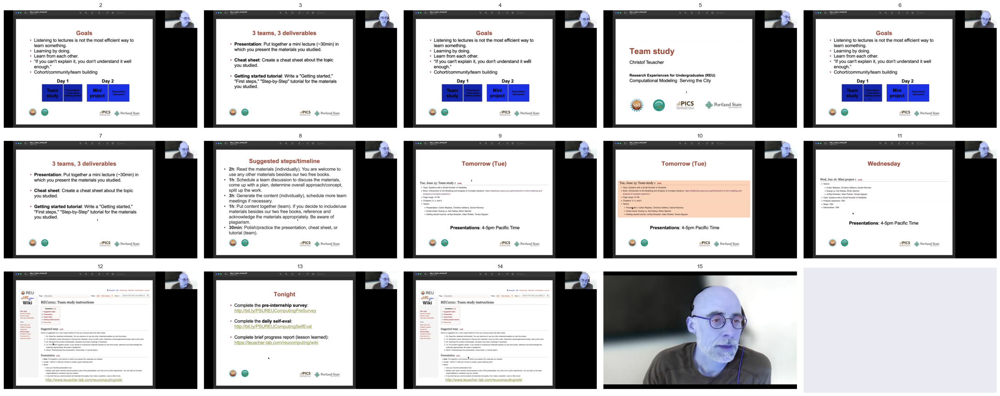

In [71]:
num_cols = 5
num_rows = (len(slides_true) // num_cols) + 1
fig, ax = plt.subplots(num_rows, num_cols, figsize=(30, 4 * num_rows))
for a in ax.flatten():
    a.grid(False)
    a.set_xticks([])
    a.set_yticks([])
for i, (s, a) in enumerate(zip(slides_true, ax.flatten())):
    a.imshow(s)
    a.set_title(i + 2)
plt.tight_layout()
plt.show()

## Extracted slides - based on predicted slide changes

In [72]:
predictions = signals.query("signal").reset_index(drop=True)
predictions.head()

,elapsed_dt,signal
0,1970-01-01 00:08:09,True
1,1970-01-01 00:10:51,True
2,1970-01-01 00:13:45,True
3,1970-01-01 00:14:02,True
4,1970-01-01 00:14:38,True


In [73]:
predictions['second'] = (predictions.elapsed_dt - pd.to_datetime('1970-01-01', format='%Y-%m-%d %H:%M:%S')).dt.total_seconds().astype(int)
predictions['fps_frame'] = (predictions.second * fps).astype(int)
predictions = predictions.merge(sec_to_frame[['second', 'frame']], how='left', on='second') \
           .rename(columns={'frame': 's2f_frame'})
predictions['slide'] = predictions.index + 2
predictions.head()

,elapsed_dt,signal,second,fps_frame,s2f_frame,slide
0,1970-01-01 00:08:09,True,489,12225,12243,2
1,1970-01-01 00:10:51,True,651,16275,16289,3
2,1970-01-01 00:13:45,True,825,20625,20641,4
3,1970-01-01 00:14:02,True,842,21050,21061,5
4,1970-01-01 00:14:38,True,878,21950,21961,6


In [74]:
slides_pred = []
for i, ts in enumerate(predictions.s2f_frame):
    vidcap.set(1, ts)
    success, s = vidcap.read()
    if not success:
        raise ValueError(f"Slide {i} at second mark {ts} not read correctly")
    slides_pred.append(s)

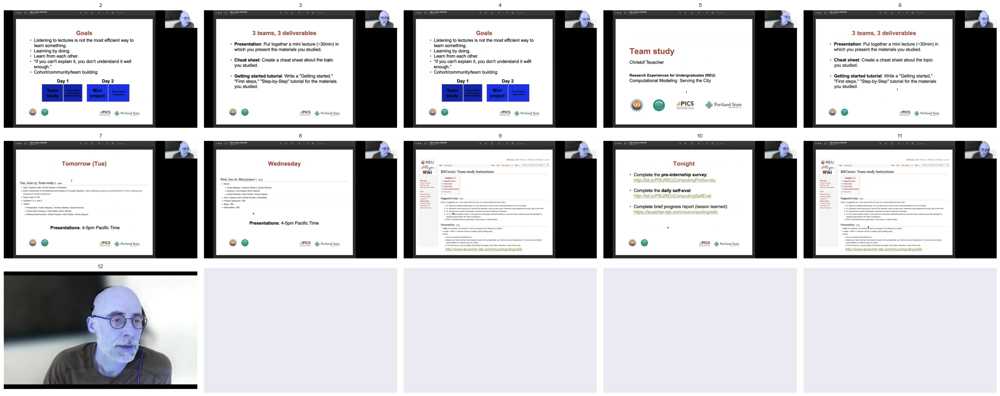

In [75]:
num_cols = 5
num_rows = (len(slides_pred) // num_cols) + 1
fig, ax = plt.subplots(num_rows, num_cols, figsize=(30, 4 * num_rows))
for a in ax.flatten():
    a.grid(False)
    a.set_xticks([])
    a.set_yticks([])
for i, (s, a) in enumerate(zip(slides_pred, ax.flatten())):
    a.imshow(s)
    a.set_title(i + 2)
plt.tight_layout()
plt.show()

# Calculate Word Counts - ground truth

In [76]:
wc_true = []
for f in slides_true:
    color_coverted = cv2.cvtColor(f, cv2.COLOR_BGR2RGB)
    extracted = pytesseract.image_to_string(color_coverted)
    wc = len(regexp_tokenize(extracted, pattern='\w+'))
    wc_true.append(wc)

In [77]:
wc_true_df = pd.DataFrame({'wc': wc_true})
wc_true_df['slide'] = wc_true_df.index + 2
wc_true_df['wc_type'] = 'true'
wc_true_df.head()

,wc,slide,wc_type
0,54,2,true
1,60,3,true
2,52,4,true
3,21,5,true
4,51,6,true


# Calculate Word Counts - predictions

In [78]:
wc_pred = []
for f in slides_pred:
    color_coverted = cv2.cvtColor(f, cv2.COLOR_BGR2RGB)
    extracted = pytesseract.image_to_string(color_coverted)
    wc = len(regexp_tokenize(extracted, pattern='\w+'))
    wc_pred.append(wc)

In [79]:
wc_pred_df = pd.DataFrame({'wc': wc_pred})
wc_pred_df['slide'] = wc_pred_df.index + 2
wc_pred_df['wc_type'] = 'pred'
wc_pred_df.head()

,wc,slide,wc_type
0,52,2,pred
1,60,3,pred
2,52,4,pred
3,21,5,pred
4,61,6,pred


# Visualize word counts

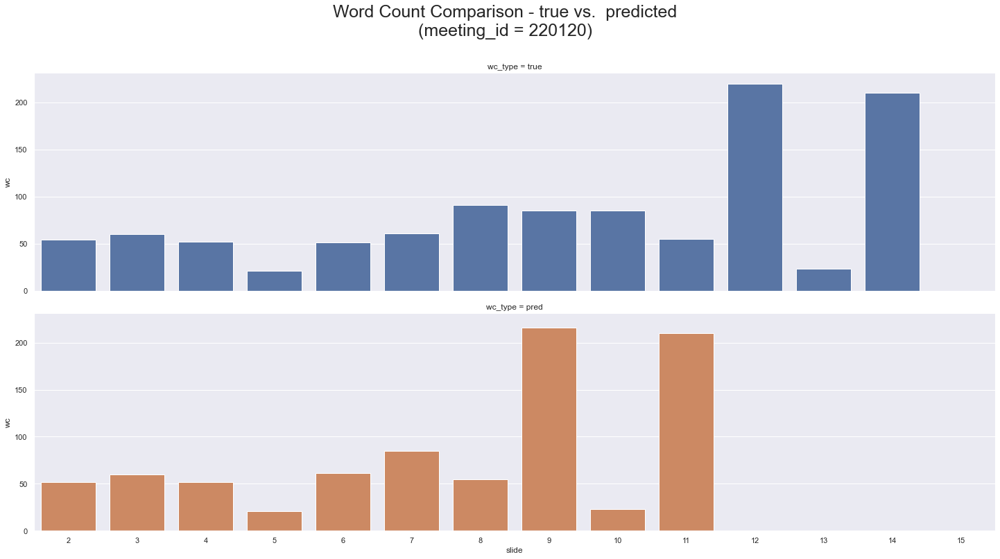

In [80]:
wc_df = pd.concat([wc_true_df, wc_pred_df])
sns.catplot(x='slide', y='wc', row='wc_type', data=wc_df, kind='bar',
            hue='wc_type', dodge=False, height=5, aspect=4)
plt.suptitle(f"Word Count Comparison - true vs.  predicted\n(meeting_id = {meeting_id})", size=25, y=1.1);

In [81]:
wc_df['meeting_id'] = meeting_id
out_df = pd.concat([out_df, wc_df])

---
# Meeting ID = 170127
---

# Set video variables and build paths

In [31]:
meeting_id = 170127

In [32]:
video_path = glob.glob(f'zoom_data/{meeting_id}/*.mp4')[0]
print(video_path)
diff_path = f'diff_data/diffs_{meeting_id}_pct_masked_cossim.csv'
sc_labels = f'slide_change_labels/{meeting_id}.csv'
interval_path = 'interval_data/intervals.csv'

zoom_data/170127/GMT20210614-170127_Recording_2350x1322.mp4


# Load true slide changes

In [33]:
sldf = load_slide_changes(sc_labels)
sldf.head()

,change_time,note,change_time_dt
0,0:00:57,NaN,1970-01-01 00:00:57
1,0:1:29,NaN,1970-01-01 00:01:29
2,0:2:07,NaN,1970-01-01 00:02:07
3,0:3:35,NaN,1970-01-01 00:03:35
4,0:5:37,NaN,1970-01-01 00:05:37


# Load Video

In [34]:
vidcap = VideoCapture(video_path)

In [35]:
fps = vidcap.get(CAP_PROP_FPS)
fps

25.0

# Get slide change predictions

In [36]:
ddiffs = load_diffs(diff_path, fps)
idf = load_intervals(interval_path, meeting_id=meeting_id)
ddiffs = filter_video(ddiffs, idf)

In [37]:
hmm_model = hmm.GaussianHMM(n_components=2)
signals = get_hmm_signals(ddiffs, hmm_model)
signals.loc[:, 'signal'] = signals.signal.astype(bool)
signals.head()

,elapsed_dt,signal
0,1970-01-01 00:00:01,False
1,1970-01-01 00:00:02,False
2,1970-01-01 00:00:03,False
3,1970-01-01 00:00:04,False
4,1970-01-01 00:00:05,False


# Map seconds to frames

In [38]:
diffs = pd.read_csv(diff_path, usecols=['meeting_id', 'cos_sim'])
diffs['frame'] = diffs.index + 1
diffs['cos_sim'] = 1 - diffs.cos_sim
diffs['second'] = diffs.index.to_numpy() // fps
diffs['is_max'] = diffs.groupby(['meeting_id', 'second'], as_index=False).cos_sim.transform(lambda x: (x == x.max()).astype(int))

In [39]:
_ddiffs = diffs.groupby(['meeting_id', 'second'], as_index=False)[['cos_sim']].max()
sec_to_frame = _ddiffs.merge(diffs[['meeting_id', 'second', 'cos_sim', 'frame']], how='left', on=['meeting_id', 'second', 'cos_sim']) \
                      .groupby(['meeting_id', 'second', 'cos_sim'], as_index=False) \
                      .frame \
                      .max()
sec_to_frame.head()

,meeting_id,second,cos_sim,frame
0,170127,0.0,1.000000e+00,9
1,170127,1.0,-7.305268e-14,50
2,170127,2.0,4.460693e-05,54
3,170127,3.0,6.199128e-06,81
4,170127,4.0,-1.076916e-13,125


In [40]:
sldf['second'] = (sldf.change_time_dt - pd.to_datetime('1970-01-01', format='%Y-%m-%d %H:%M:%S')).dt.total_seconds().astype(int)
sldf['fps_frame'] = (sldf.second * fps).astype(int)
sldf = sldf.merge(sec_to_frame[['second', 'frame']], how='left', on='second') \
           .rename(columns={'frame': 's2f_frame'})
sldf['slide'] = sldf.index + 2
sldf.head()

,change_time,note,change_time_dt,second,fps_frame,s2f_frame,slide
0,0:00:57,NaN,1970-01-01 00:00:57,57,1425,1429,2
1,0:1:29,NaN,1970-01-01 00:01:29,89,2225,2246,3
2,0:2:07,NaN,1970-01-01 00:02:07,127,3175,3192,4
3,0:3:35,NaN,1970-01-01 00:03:35,215,5375,5377,5
4,0:5:37,NaN,1970-01-01 00:05:37,337,8425,8430,6


# Visualize

## Raw diffs

In [77]:
p = figure(plot_width=1400, plot_height=500)
p.line(diffs.frame, diffs.cos_sim, line_width=2, line_alpha=0.5)
show(p)

## Discretized diffs with predictions and ground truth slide changes

In [78]:
plot_slide_diffs(ddiffs, sldf=sldf, signals=signals)

Figure(id='12720', ...)

## Extracted slides - based on ground truth annotations

In [41]:
slides_true = []
for i, ts in enumerate(sldf.s2f_frame):
    vidcap.set(1, ts)
    success, s = vidcap.read()
    if not success:
        raise ValueError(f"Slide {i} at second mark {ts} not read correctly")
    slides_true.append(s)

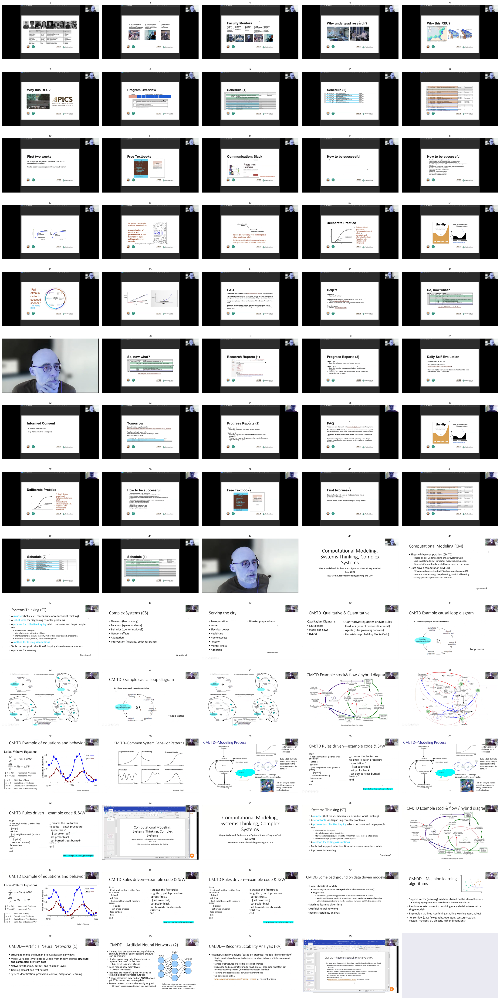

In [95]:
num_cols = 5
num_rows = math.ceil(len(slides_true) / num_cols)
fig, ax = plt.subplots(num_rows, num_cols, figsize=(30, 4 * num_rows))
for a in ax.flatten():
    a.grid(False)
    a.set_xticks([])
    a.set_yticks([])
for i, (s, a) in enumerate(zip(slides_true, ax.flatten())):
    a.imshow(s)
    a.set_title(i + 2)
plt.tight_layout()
plt.show()

## Extracted slides - based on predicted slide changes

In [42]:
predictions = signals.query("signal").reset_index(drop=True)
predictions.head()

,elapsed_dt,signal
0,1970-01-01 00:00:57,True
1,1970-01-01 00:01:29,True
2,1970-01-01 00:02:07,True
3,1970-01-01 00:03:35,True
4,1970-01-01 00:05:36,True


In [43]:
predictions['second'] = (predictions.elapsed_dt - pd.to_datetime('1970-01-01', format='%Y-%m-%d %H:%M:%S')).dt.total_seconds().astype(int)
predictions['fps_frame'] = (predictions.second * fps).astype(int)
predictions = predictions.merge(sec_to_frame[['second', 'frame']], how='left', on='second') \
           .rename(columns={'frame': 's2f_frame'})
predictions['slide'] = predictions.index + 2
predictions.head()

,elapsed_dt,signal,second,fps_frame,s2f_frame,slide
0,1970-01-01 00:00:57,True,57,1425,1429,2
1,1970-01-01 00:01:29,True,89,2225,2246,3
2,1970-01-01 00:02:07,True,127,3175,3192,4
3,1970-01-01 00:03:35,True,215,5375,5377,5
4,1970-01-01 00:05:36,True,336,8400,8420,6


In [44]:
slides_pred = []
for i, ts in enumerate(predictions.s2f_frame):
    vidcap.set(1, ts)
    success, s = vidcap.read()
    if not success:
        raise ValueError(f"Slide {i} at second mark {ts} not read correctly")
    slides_pred.append(s)

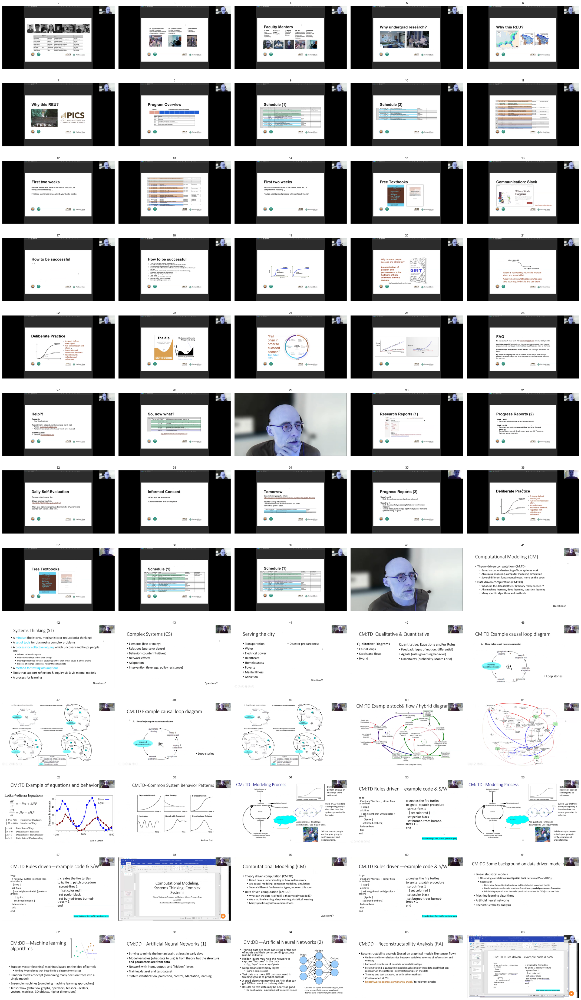

In [99]:
num_cols = 5
num_rows = math.ceil(len(slides_pred) / num_cols)
fig, ax = plt.subplots(num_rows, num_cols, figsize=(30, 4 * num_rows))
for a in ax.flatten():
    a.grid(False)
    a.set_xticks([])
    a.set_yticks([])
for i, (s, a) in enumerate(zip(slides_pred, ax.flatten())):
    a.imshow(s)
    a.set_title(i + 2)
plt.tight_layout()
plt.show()

# Calculate Word Counts - ground truth

In [45]:
wc_true = []
for f in slides_true:
    color_coverted = cv2.cvtColor(f, cv2.COLOR_BGR2RGB)
    extracted = pytesseract.image_to_string(color_coverted)
    wc = len(regexp_tokenize(extracted, pattern='\w+'))
    wc_true.append(wc)

In [46]:
wc_true_df = pd.DataFrame({'wc': wc_true})
wc_true_df['slide'] = wc_true_df.index + 2
wc_true_df['wc_type'] = 'true'
wc_true_df.head()

,wc,slide,wc_type
0,73,2,true
1,35,3,true
2,42,4,true
3,0,5,true
4,45,6,true


# Calculate Word Counts - predictions

In [47]:
wc_pred = []
for f in slides_pred:
    color_coverted = cv2.cvtColor(f, cv2.COLOR_BGR2RGB)
    extracted = pytesseract.image_to_string(color_coverted)
    wc = len(regexp_tokenize(extracted, pattern='\w+'))
    wc_pred.append(wc)

In [48]:
wc_pred_df = pd.DataFrame({'wc': wc_pred})
wc_pred_df['slide'] = wc_pred_df.index + 2
wc_pred_df['wc_type'] = 'predicted'
wc_pred_df.head()

,wc,slide,wc_type
0,73,2,predicted
1,35,3,predicted
2,42,4,predicted
3,0,5,predicted
4,41,6,predicted


# Visualize word counts

/Users/jackcan/miniconda3/envs/thesis/lib/python3.7/site-packages/ipykernel_launcher.py:9: UserWarning: FixedFormatter should only be used together with FixedLocator
  if __name__ == '__main__':


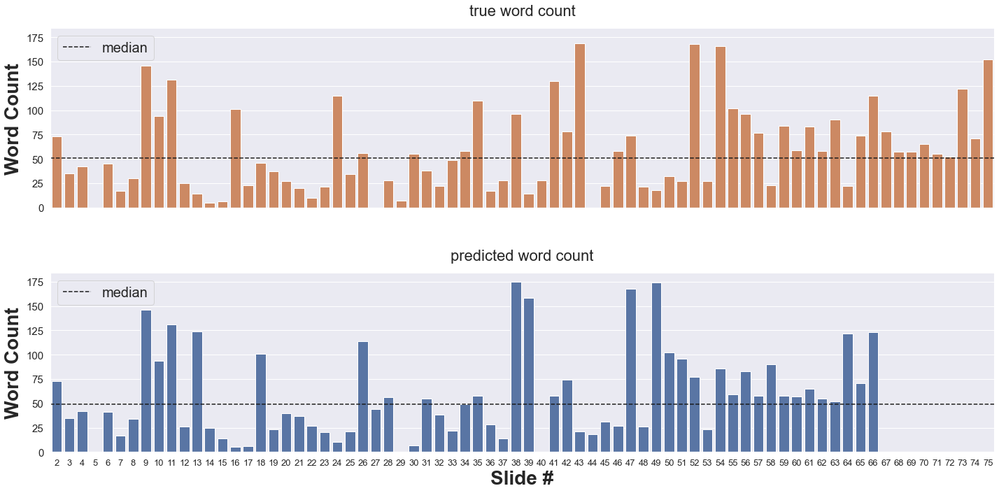

In [50]:
wc_df = pd.concat([wc_true_df, wc_pred_df])
g = sns.catplot(x='slide', y='wc', row='wc_type', row_order=['true', 'predicted'], data=wc_df, kind='bar',
               hue='wc_type', hue_order=['predicted', 'true'], dodge=False, height=5, aspect=4)
g.map_dataframe(add_median, linestyle='dashed', color='k', label='median')
g.set_titles(row_template="{row_name} word count", size=22, y=1.05)
g.set_xlabels("Slide #", size=28, fontweight='bold')
for ax in g.axes.flat:
    ax.set_ylabel("Word Count", size=28, fontweight='bold')
    ax.set_yticklabels(ax.get_yticklabels(), size=15)
    ax.set_xticklabels(ax.get_xticklabels(), size=13)
    handles, labels = ax.get_legend_handles_labels()
    for handle, label in zip(handles, labels):
        if label == 'median':
            ax.legend([handle], [label], loc='upper left', fontsize=20)
g.tight_layout(h_pad=4)
plt.savefig("thesis/mscs_thesis/figures/3_3_2_hmm_wc_170127.pdf", dpi=300, bbox_inches='tight')
#plt.suptitle(f"Word Count Comparison - true vs.  predicted\n(meeting_id = {meeting_id})", size=25, y=1.1);

In [105]:
wc_df['meeting_id'] = meeting_id
out_df = pd.concat([out_df, wc_df])

---
# Meeting ID = 89526605115
---

# Set video variables and build paths

In [24]:
meeting_id = 89526605115

In [25]:
video_path = glob.glob(f'zoom_data/89526605115/GMT20211206-231322_Recording_as_1280x800.mp4')[0]
print(video_path)
diff_path = f'diff_data/diffs_{meeting_id}_cossim.csv'
interval_path = 'interval_data/intervals.csv'

zoom_data/89526605115/GMT20211206-231322_Recording_as_1280x800.mp4


# Load Video

In [26]:
vidcap = VideoCapture(video_path)

In [27]:
fps = vidcap.get(CAP_PROP_FPS)
fps

25.0

# Get slide change predictions

In [28]:
ddiffs = load_diffs(diff_path, fps)
idf = load_intervals(interval_path, meeting_id=meeting_id)
ddiffs = filter_video(ddiffs, idf)

In [29]:
hmm_model = hmm.GaussianHMM(n_components=2)
signals = get_hmm_signals(ddiffs, hmm_model)
signals.loc[:, 'signal'] = signals.signal.astype(bool)
signals.head()

,elapsed_dt,signal
0,1970-01-01 00:07:20,False
1,1970-01-01 00:07:21,False
2,1970-01-01 00:07:22,False
3,1970-01-01 00:07:23,False
4,1970-01-01 00:07:24,False


# Map seconds to frames

In [30]:
diffs = pd.read_csv(diff_path, usecols=['meeting_id', 'cos_sim'])
diffs['frame'] = diffs.index + 1
diffs['cos_sim'] = 1 - diffs.cos_sim
diffs['second'] = diffs.index.to_numpy() // fps
diffs['is_max'] = diffs.groupby(['meeting_id', 'second'], as_index=False).cos_sim.transform(lambda x: (x == x.max()).astype(int))

In [31]:
_ddiffs = diffs.groupby(['meeting_id', 'second'], as_index=False)[['cos_sim']].max()
sec_to_frame = _ddiffs.merge(diffs[['meeting_id', 'second', 'cos_sim', 'frame']], how='left', on=['meeting_id', 'second', 'cos_sim']) \
                      .groupby(['meeting_id', 'second', 'cos_sim'], as_index=False) \
                      .frame \
                      .max()
sec_to_frame.head()

,meeting_id,second,cos_sim,frame
0,89526605115,0.0,0.016874,23
1,89526605115,1.0,0.033048,48
2,89526605115,2.0,0.035941,73
3,89526605115,3.0,0.007090,98
4,89526605115,4.0,0.039337,123


# Visualize

## Raw diffs

In [32]:
p = figure(plot_width=1400, plot_height=500)
p.line(diffs.frame, diffs.cos_sim, line_width=2, line_alpha=0.5)
show(p)

## Discretized diffs with predictions and ground truth slide changes

In [34]:
p = plot_slide_diffs(ddiffs, sldf=None, signals=signals)
show(p)

## Extracted slides - based on predicted slide changes

In [35]:
predictions = signals.query("signal").reset_index(drop=True)
predictions.head()

,elapsed_dt,signal
0,1970-01-01 00:08:02,True
1,1970-01-01 00:08:06,True
2,1970-01-01 00:08:35,True
3,1970-01-01 00:09:18,True
4,1970-01-01 00:10:17,True


In [36]:
predictions['second'] = (predictions.elapsed_dt - pd.to_datetime('1970-01-01', format='%Y-%m-%d %H:%M:%S')).dt.total_seconds().astype(int)
predictions['fps_frame'] = (predictions.second * fps).astype(int)
predictions = predictions.merge(sec_to_frame[['second', 'frame']], how='left', on='second') \
           .rename(columns={'frame': 's2f_frame'})
predictions['slide'] = predictions.index + 2
predictions.head()

,elapsed_dt,signal,second,fps_frame,s2f_frame,slide
0,1970-01-01 00:08:02,True,482,12050,12063,2
1,1970-01-01 00:08:06,True,486,12150,12160,3
2,1970-01-01 00:08:35,True,515,12875,12891,4
3,1970-01-01 00:09:18,True,558,13950,13974,5
4,1970-01-01 00:10:17,True,617,15425,15444,6


In [37]:
slides_pred = []
for i, ts in enumerate(predictions.s2f_frame):
    vidcap.set(1, ts)
    success, s = vidcap.read()
    if not success:
        raise ValueError(f"Slide {i} at second mark {ts} not read correctly")
    s = mask_rh_corner(s, 0.17, 0.16)
    slides_pred.append(s)

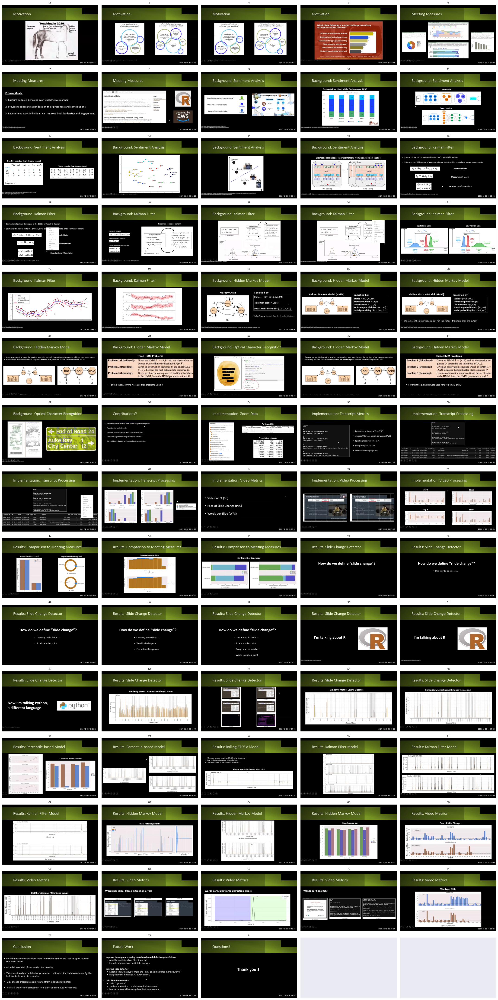

In [38]:
num_cols = 5
num_rows = (len(slides_pred) // num_cols) + 1
fig, ax = plt.subplots(num_rows, num_cols, figsize=(30, 4 * num_rows))
for a in ax.flatten():
    a.grid(False)
    a.set_xticks([])
    a.set_yticks([])
for i, (s, a) in enumerate(zip(slides_pred, ax.flatten())):
    a.imshow(s)
    a.set_title(i + 2)
plt.tight_layout()
plt.show()

# Calculate Word Counts - predictions

In [39]:
wc_pred = []
for f in slides_pred:
    color_coverted = cv2.cvtColor(f, cv2.COLOR_BGR2RGB)
    extracted = pytesseract.image_to_string(color_coverted)
    wc = len(regexp_tokenize(extracted, pattern='\w+'))
    wc_pred.append(wc)

In [40]:
wc_pred_df = pd.DataFrame({'wc': wc_pred})
wc_pred_df['slide'] = wc_pred_df.index + 2
wc_pred_df['wc_type'] = 'predicted'
wc_pred_df.head()

,wc,slide,wc_type
0,29,2,predicted
1,81,3,predicted
2,81,4,predicted
3,82,5,predicted
4,24,6,predicted


# Visualize word counts

/Users/jackcan/miniconda3/envs/thesis/lib/python3.7/site-packages/ipykernel_launcher.py:9: UserWarning: FixedFormatter should only be used together with FixedLocator
  if __name__ == '__main__':


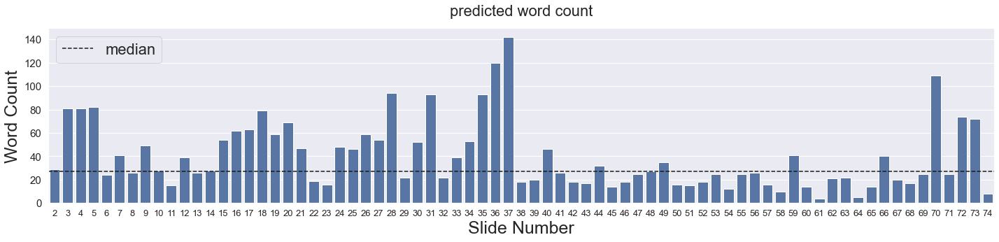

In [43]:
wc_df = pd.concat([wc_true_df, wc_pred_df])
g = sns.catplot(x='slide', y='wc', row='wc_type', data=wc_df, kind='bar',
                hue='wc_type', dodge=False, height=5, aspect=4)
g.map_dataframe(add_median, linestyle='dashed', color='k', label='median')
g.set_titles(row_template="{row_name} word count", size=22, y=1.05)
g.set_xlabels("Slide Number", size=25)
for ax in g.axes.flat:
    ax.set_ylabel("Word Count", size=25)
    ax.set_yticklabels(ax.get_yticklabels(), size=15)
    ax.set_xticklabels(ax.get_xticklabels(), size=13)
    handles, labels = ax.get_legend_handles_labels()
    for handle, label in zip(handles, labels):
        if label == 'median':
            ax.legend([handle], [label], loc='upper left', fontsize=22)
g.tight_layout(h_pad=4)
#plt.suptitle(f"Word Count Comparison - true vs.  predicted\n(meeting_id = {meeting_id})", size=25, y=1.1);

In [33]:
wc_df['meeting_id'] = meeting_id
out_df = wc_df.copy(deep=True)

# Write dataset

In [106]:
out_df.to_csv('word_counts.csv', index=False)